In [1]:
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

class ClassificationModelManager:
    """
    Manages multiple classification models for different food categories."""
    def __init__(self, classification_paths: dict):
        self.classification_models = {}
        for category, path in classification_paths.items():
            try:
                self.classification_models[category] = YOLO(path)
            except Exception as e:
                print(f"Error loading model for category '{category}': {e}")
                self.classification_models[category] = None
        
    def get_model(self, category: str):
        """Returns a specific classification model based on the category."""
        return self.classification_models.get(category)
    
    def get_all_models(self):
        """Returns all classification models. (dictionary)"""
        return self.classification_models
    
class FoodDetModel:
    def __init__(self, detection_model_path: str, classification_config: dict,
                 detection_id_to_name: str, det_to_cls_group: str):
        
        self.detection_model = YOLO(detection_model_path)

        self.cls_manager = ClassificationModelManager(classification_config)

        self.classification_models = self.cls_manager.get_all_models()

        with open(detection_id_to_name, 'r') as f:
            self.detection_id_to_name = json.load(f)

        self.name_to_id = {v: int(k) for k, v in self.detection_id_to_name.items()}

        with open(det_to_cls_group, 'r') as f:
            self.det_to_cls_group = json.load(f)

    def _expand_bbox(self, bbox, image_shape, scale=1.1):
        """Expand bounding box slightly while staying within image bounds."""
        x1, y1, x2, y2 = bbox
        w, h = x2 - x1, y2 - y1
        cx, cy = x1 + w / 2, y1 + h / 2
        new_w, new_h = w * scale, h * scale

        x1n = max(0, int(cx - new_w / 2))
        y1n = max(0, int(cy - new_h / 2))
        x2n = min(image_shape[1] - 1, int(cx + new_w / 2))
        y2n = min(image_shape[0] - 1, int(cy + new_h / 2))

        return [x1n, y1n, x2n, y2n]
    
    def run(self, image_path: str, conf_threshold=0.3, det_imgsz=640,
            vis=False, vis_crops=False, verbose=True):
        """Run detection and classification on the input image."""
        image = cv2.imread(image_path)
        if image is None:
            raise ValueError(f"Image at path '{image_path}' could not be loaded.")
        
        vis_img = image.copy() if vis else None

        ### DETECTION ###
        det_results = self.detection_model.predict(source=image, imgsz=det_imgsz, conf=conf_threshold, agnostic_nms=True, save=False, verbose=False)

        all_boxes = []
        final_outputs = []

        if vis:
            img_bgr = det_results[0].plot()
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
            plt.figure(figsize=(8, 8))
            plt.imshow(img_rgb)
            plt.axis('off')
            plt.show()

        ### CLASSIFICATION ###

        for det in det_results:
            boxes = det.boxes.xyxy.cpu().numpy()
            class_ids = det.boxes.cls.cpu().numpy()
            scores = det.boxes.conf.cpu().numpy()

            for i, box in enumerate(boxes):
                x1, y1, x2, y2 = map(int, box)
                det_class_id = int(class_ids[i])
                det_conf_score = float(scores[i])
                det_class_name = self.detection_id_to_name[str(det_class_id)]

                all_boxes.append((x1, y1, x2, y2, det_class_name, det_conf_score))

                # --- Find which segmentation model to use ---
                seg_group = None
                for group_name, class_list in self.det_to_cls_group.items():
                    if det_class_name in class_list:
                        seg_group = group_name
                        if verbose:
                            print(f"Detection '{det_class_name}' mapped to classification group '{seg_group}'")
                        break
                if seg_group is None:
                    if verbose:
                        print(f"No classification group found for detection '{det_class_name}'. Skipping classification.")
                    
                    final_outputs.append({
                        "pred_class_name": det_class_name,
                        "pred_class_id": det_class_id,
                        "bbox": [x1, y1, x2, y2],
                        "det_class_name": det_class_name,
                        "det_conf_score": det_conf_score,
                        "cls_group": None,
                        "top5_cls_results": []
                    })
                    continue

                expanded_box = self._expand_bbox((x1, y1, x2, y2), image.shape)
                ex1, ey1, ex2, ey2 = expanded_box
                crop_img = image[ey1:ey2, ex1:ex2].copy()

                cls_model = self.classification_models.get(seg_group)
                if cls_model is None:
                    if verbose:
                        print(f"No classification model found for group '{seg_group}'. Skipping classification.")
                    
                    final_outputs.append({
                        "pred_class_name": det_class_name,
                        "pred_class_id": det_class_id,
                        "bbox": [x1, y1, x2, y2],
                        "det_class_name": det_class_name,
                        "det_conf_score": det_conf_score,
                        "cls_group": seg_group,
                        "top5_cls_results": []
                    })
                    continue

                cls_results = cls_model.predict(source=crop_img, verbose=False)

                ## Process classification results
                top5 = []
                if cls_results and cls_results[0].probs is not None:
                    cls_res = cls_results[0]

                    names = cls_res.names
                    top5cls_ids = cls_res.probs.top5
                    top5probs = cls_res.probs.top5conf

                    for idx, prob in zip(top5cls_ids, top5probs):
                        top5.append({
                            "class_name": names[idx],
                            "probability": float(prob)
                        })
                final_outputs.append({
                    "pred_class_name": top5[0]["class_name"] if top5 else det_class_name,
                    "pred_class_id": self.name_to_id.get(top5[0]["class_name"], det_class_id) if top5 else det_class_id,
                    "bbox": [x1, y1, x2, y2],
                    "det_class_name": det_class_name,
                    "det_conf_score": det_conf_score,
                    "cls_group": seg_group,
                    "top5_cls_results": top5
                })

                if vis_crops:
                    for cls_res in cls_results:
                        im_array = cls_res.plot()
                        img_rgb = cv2.cvtColor(im_array, cv2.COLOR_BGR2RGB)
                        plt.figure(figsize=(6, 6))
                        plt.imshow(img_rgb)
                        plt.axis('off')
                        plt.show()

        return final_outputs

In [2]:
clsModelsDict = ({
    "meat": "classification_models/YOLO/meat.pt",
    "vegetable": "classification_models/YOLO/vegetable.pt",
    "fruit": "classification_models/YOLO/fruit.pt",
    "cheese-dairy" : "classification_models/YOLO/cheese-dairy.pt",
    "bread-pasta-grains": "classification_models/YOLO/bread-pasta-grains.pt",
    "nuts-seeds": "classification_models/YOLO/nuts-seeds.pt",
    "misc": "classification_models/YOLO/misc.pt",
})

model = FoodDetModel(
    detection_model_path="runs/detect/yolo_det_v4_m/weights/best.pt",
    classification_config=clsModelsDict,
    detection_id_to_name="pipeline_data/dicts/detect_classes_v4.json",
    det_to_cls_group="pipeline_data/dicts/det_to_cls_groups.json"
)


In [3]:
import importlib
import FoodDetection

importlib.reload(FoodDetection)

from FoodDetection import FoodDetectionModel

In [4]:
app_model = FoodDetectionModel(
    detection_model_path="runs/detect/yolo_det_v4_m/weights/best.pt",
    classification_config=clsModelsDict,
    detection_id_to_name="pipeline_data/dicts/detect_classes_v4.json",
    det_to_cls_group="pipeline_data/dicts/det_to_cls_groups.json"
)

In [5]:
results = app_model.run("data/test_pics/Salmon-Bowl-SQ-2.jpg", conf_threshold=0.3, det_imgsz=1800, verbose=True)
print(results)

WARNING imgsz=[1800] must be multiple of max stride 32, updating to [1824]
Detection 'carrot' mapped to classification group 'vegetable'
Detection 'cucumber' mapped to classification group 'vegetable'
Detection 'cucumber' mapped to classification group 'vegetable'
Detection 'rice' mapped to classification group 'bread-pasta-grains'
Detection 'chicken' mapped to classification group 'meat'
[{'pred_class_name': 'carrot', 'pred_class_id': 21, 'bbox': [481, 760, 880, 1191], 'det_class_name': 'carrot', 'det_conf_score': 0.7969042658805847, 'cls_group': 'vegetable', 'top5_cls_results': [{'class_name': 'carrot', 'probability': 0.895331621170044}, {'class_name': 'potato', 'probability': 0.10436476767063141}, {'class_name': 'mixed-vegetables', 'probability': 7.83534487709403e-05}, {'class_name': 'red-radish', 'probability': 4.646185698220506e-05}, {'class_name': 'red-cabbage', 'probability': 3.641293369582854e-05}]}, {'pred_class_name': 'cucumber', 'pred_class_id': 31, 'bbox': [771, 221, 1195, 

In [6]:
for result in results:
    print(f"Predicted Class Name: {result['pred_class_name']}")
    print("Top3 classes to choose from:")
    for i in range(3):
        if i < len(result["top5_cls_results"]):
            cls_info = result["top5_cls_results"][i]
            print(f"  {i+1}. {cls_info['class_name']} (Probability: {cls_info['probability']:.4f})")
    print("-------------"*3)

Predicted Class Name: carrot
Top3 classes to choose from:
  1. carrot (Probability: 0.8953)
  2. potato (Probability: 0.1044)
  3. mixed-vegetables (Probability: 0.0001)
---------------------------------------
Predicted Class Name: cucumber
Top3 classes to choose from:
  1. cucumber (Probability: 1.0000)
  2. mixed-vegetables (Probability: 0.0000)
  3. broccoli (Probability: 0.0000)
---------------------------------------
Predicted Class Name: rice
Top3 classes to choose from:
  1. rice (Probability: 0.9998)
  2. pasta (Probability: 0.0002)
  3. quinoa (Probability: 0.0000)
---------------------------------------
Predicted Class Name: chicken
Top3 classes to choose from:
  1. chicken (Probability: 0.9134)
  2. beef (Probability: 0.0848)
  3. shrimp-prawn-large (Probability: 0.0011)
---------------------------------------


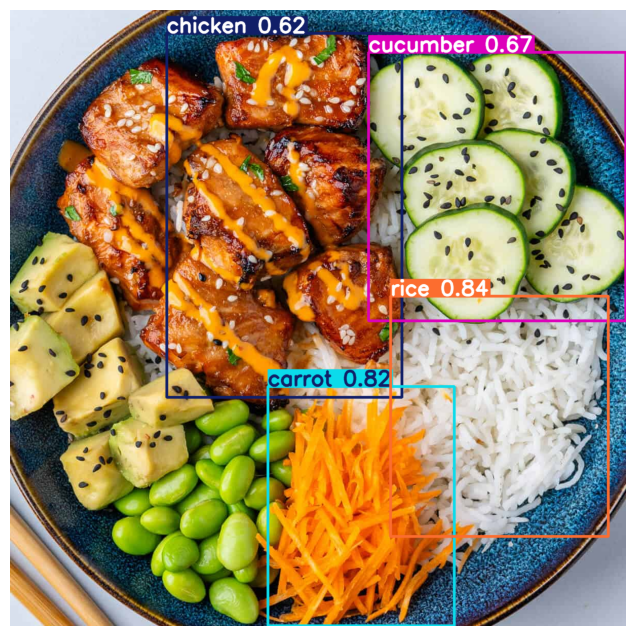

Detection 'rice' mapped to classification group 'bread-pasta-grains'


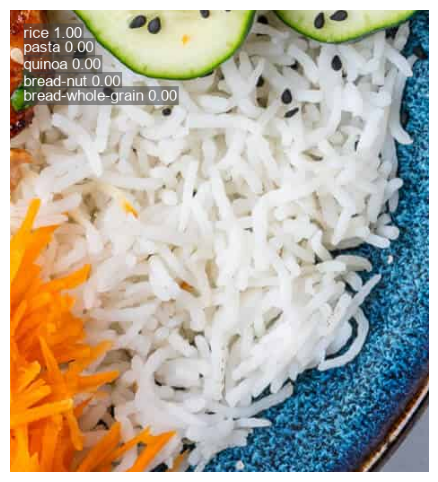

Detection 'carrot' mapped to classification group 'vegetable'


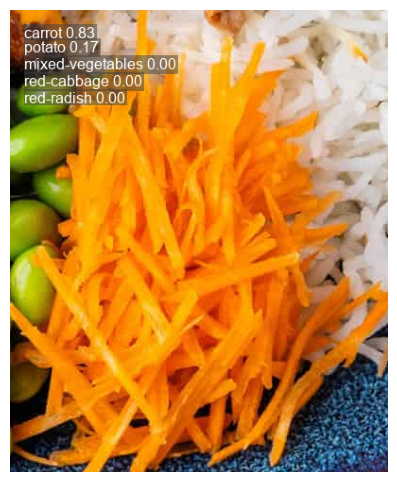

Detection 'cucumber' mapped to classification group 'vegetable'


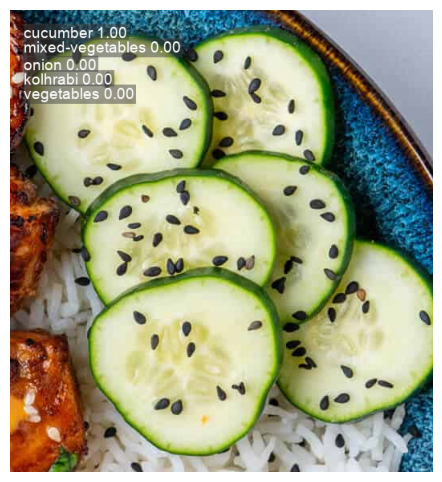

Detection 'chicken' mapped to classification group 'meat'


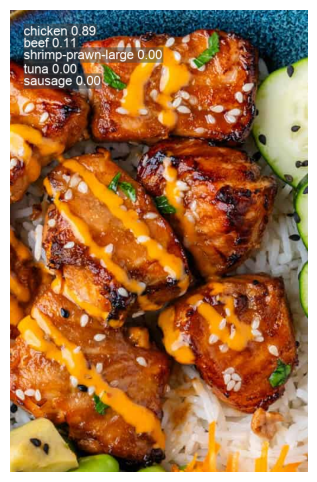

In [12]:
output = model.run(image_path="data/test_pics/Salmon-Bowl-SQ-2.jpg", conf_threshold=0.3, det_imgsz=1024,
          vis=True, vis_crops=True, verbose=True)

In [4]:
for obj in output:
    # print(f"Detected_class {obj['det_class_name']}, Most probable class {obj['top5_cls_results'][0]['class_name']} with probability {obj['top5_cls_results'][0]['probability']*100:.2f}%")
    print(f"Predicted class: {obj['pred_class_name']} (ID: {obj['pred_class_id']})")

NameError: name 'output' is not defined

In [24]:
import os
import json
import numpy as np
from sklearn.metrics import f1_score, hamming_loss, jaccard_score
from tqdm import tqdm


def evaluate_multilabel_detection(model, val_img_dir, binary_labels_val_dir, detect_dict_path):
    """
    Runs multilabel evaluation for a detection model.
    
    Parameters
    ----------
    model : object
        Detection model with .run(...) method returning detections.
    val_img_dir : str
        Path to directory with validation images.
    binary_labels_val_dir : str
        Path to directory with binary multilabel .txt files.
    detect_dict_path : str
        Path to JSON file mapping class names/IDs. Size determines num_classes.
    
    Returns
    -------
    dict
        Dictionary with metrics: macro_f1, micro_f1, hamming_loss, jaccard_score.
    """

    # Load detection dictionary → determine number of classes
    with open(detect_dict_path, "r") as f:
        detection_dict = json.load(f)
    num_classes = len(detection_dict)

    all_y_true = []
    all_y_pred = []

    print(f"Starting evaluation of {len(os.listdir(val_img_dir))} files...")

    img_files = [f for f in os.listdir(val_img_dir) if f.lower().endswith((".jpg", ".png"))]

    bar_format = "{l_bar}{bar} {n_fmt}/{total_fmt} [{elapsed}<{remaining}]"

    for file_name in tqdm(
        img_files,
        desc="Evaluating",
        bar_format=bar_format,
        leave=True,
    ):

        img_path = os.path.join(val_img_dir, file_name)

        # Run model
        output = model.run(
            image_path=img_path,
            conf_threshold=0.3,
            det_imgsz=640,
            vis=False,
            vis_crops=False,
            verbose=False
        )

        # Load ground-truth labels
        y_true_file = os.path.join(
            binary_labels_val_dir,
            file_name.replace(".jpg", ".txt").replace(".png", ".txt")
        )

        try:
            with open(y_true_file, "r") as f:
                y_true = [int(x) for x in f.read().strip().split()]
        except FileNotFoundError:
            continue

        # Extract unique predicted classes
        unique_pred_classes = set()
        for det in output:
            unique_pred_classes.add(det["pred_class_id"])

        # Create binary prediction vector
        y_pred = [1 if i in unique_pred_classes else 0 for i in range(num_classes)]

        all_y_true.append(y_true)
        all_y_pred.append(y_pred)

    # Convert lists to NumPy arrays
    Y_true_np = np.array(all_y_true)
    Y_pred_np = np.array(all_y_pred)

    print(f"Processed {len(Y_true_np)} samples.")

    # Compute metrics
    macro_f1 = f1_score(Y_true_np, Y_pred_np, average="macro", zero_division=0)
    micro_f1 = f1_score(Y_true_np, Y_pred_np, average="micro", zero_division=0)
    h_loss = hamming_loss(Y_true_np, Y_pred_np)
    j_score = jaccard_score(Y_true_np, Y_pred_np, average="samples", zero_division=0)

    print("\n--- Multi-label Classification Metrics ---")
    print(f"Macro F1:   {macro_f1:.4f}")
    print(f"Micro F1:   {micro_f1:.4f}")
    print(f"Hamming:    {h_loss:.4f}")
    print(f"Jaccard:    {j_score:.4f}")

    return {
        "macro_f1": macro_f1,
        "micro_f1": micro_f1,
        "hamming_loss": h_loss,
        "jaccard_score": j_score
    }

In [25]:
metrics = evaluate_multilabel_detection(
    model=model,
    val_img_dir="data/dataset_v4/val/images",
    binary_labels_val_dir="data/dataset_v4/val/binary_labels",
    detect_dict_path="pipeline_data/dicts/detect_classes_v4.json"
)

Starting evaluation of 3599 files...


Evaluating: 100%|██████████ 3599/3599 [01:53<00:00]

Processed 3599 samples.

--- Multi-label Classification Metrics ---
Macro F1:   0.7593
Micro F1:   0.7635
Hamming:    0.0067
Jaccard:    0.7087


Processing image: data/test_pics/dom\610cc69d-8f6a-4e80-962d-427eb4e8efe8.jpg


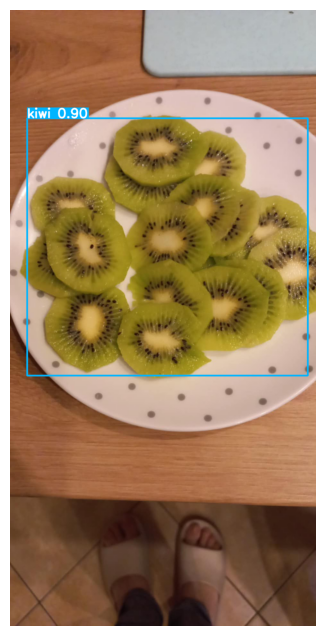

Detection 'kiwi' mapped to classification group 'fruit'


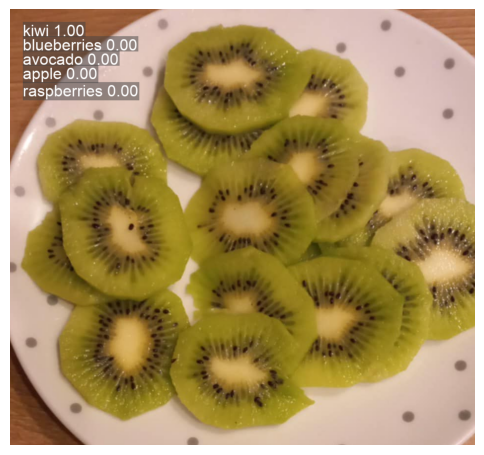

Processing image: data/test_pics/dom\8883fa71-ec6e-4fc2-bc73-5a43dcd815f5.jpg


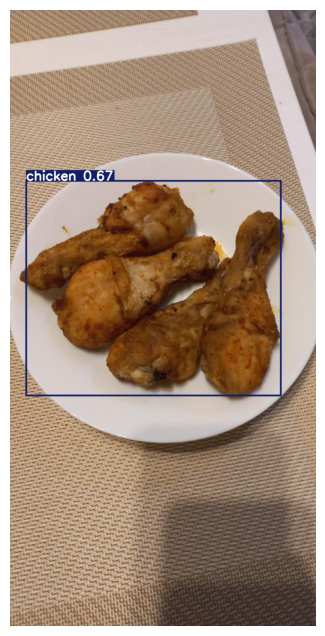

Detection 'chicken' mapped to classification group 'meat'


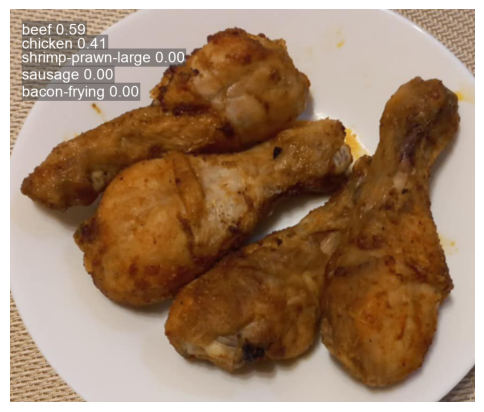

Processing image: data/test_pics/dom\ae86f72f-03c3-4a44-81f9-f7819400c7d8.jpg


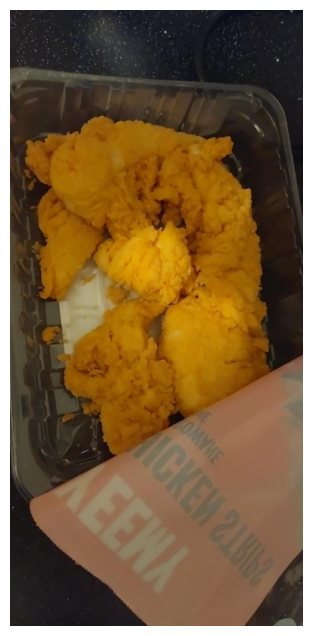

Processing image: data/test_pics/dom\apple.jpg


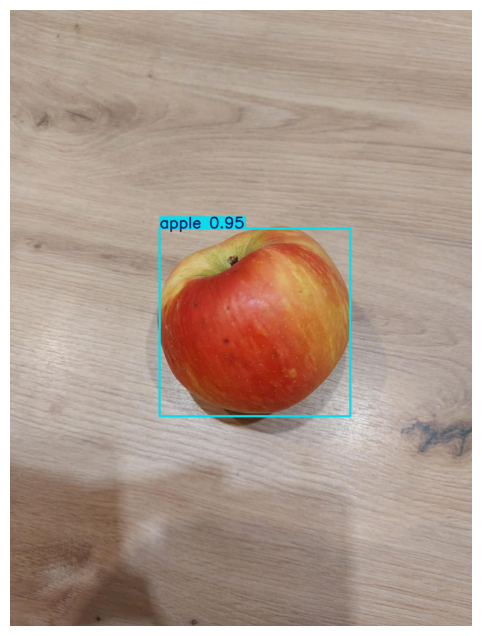

Detection 'apple' mapped to classification group 'fruit'


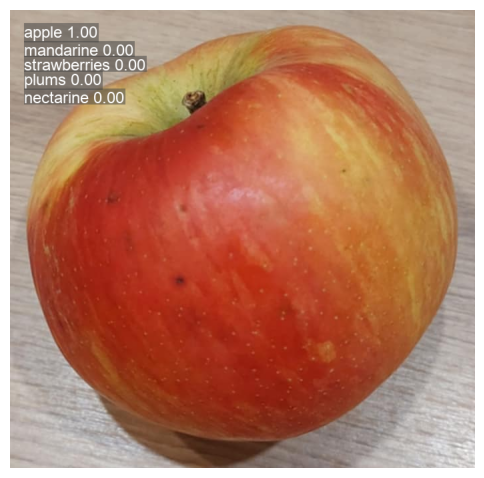

Processing image: data/test_pics/dom\b70cf4b9-261f-4c66-8ab5-15cefc6de3a1.jpg


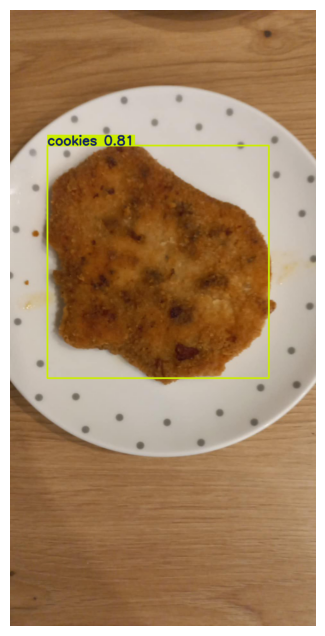

Detection 'cookies' mapped to classification group 'misc'


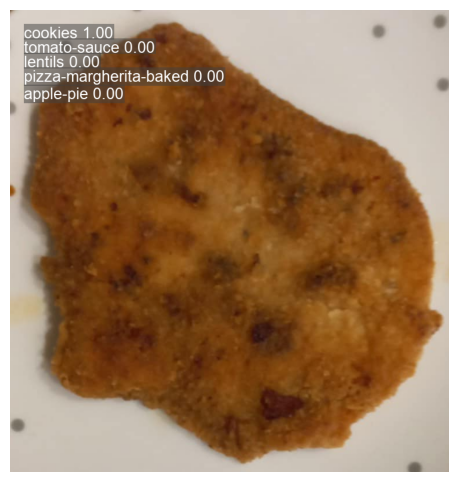

Processing image: data/test_pics/dom\bread1.jpg


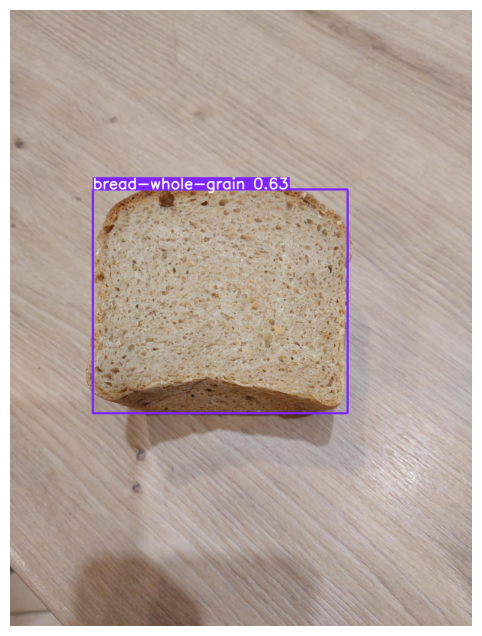

Detection 'bread-whole-grain' mapped to classification group 'bread-pasta-grains'


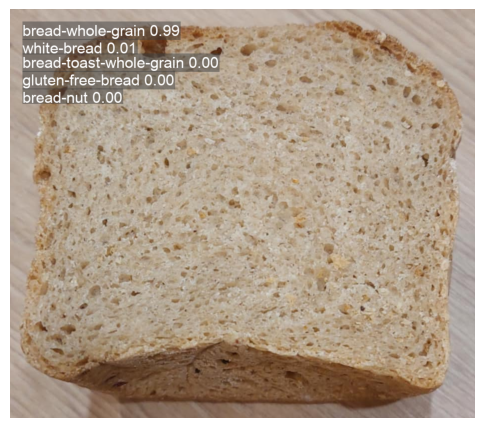

Processing image: data/test_pics/dom\bread2.jpg


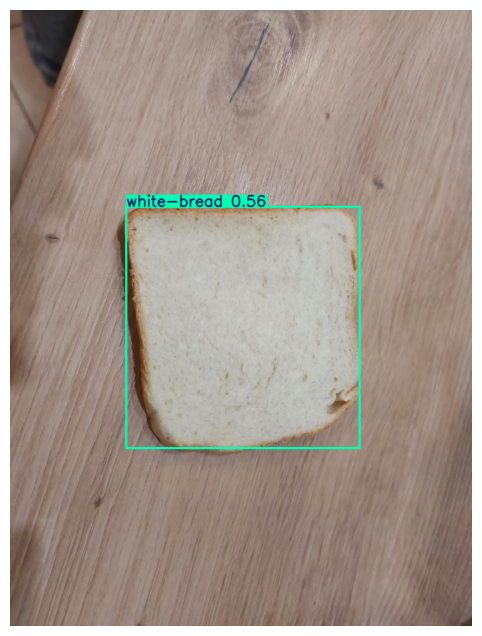

Detection 'white-bread' mapped to classification group 'bread-pasta-grains'


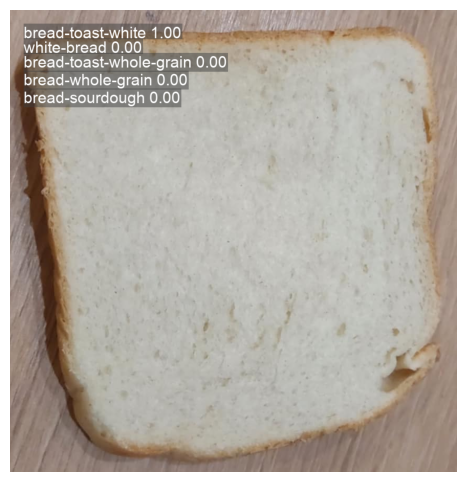

Processing image: data/test_pics/dom\bread3.jpg


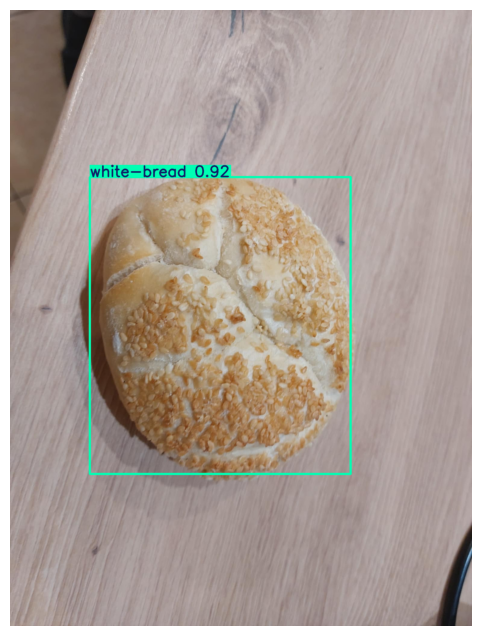

Detection 'white-bread' mapped to classification group 'bread-pasta-grains'


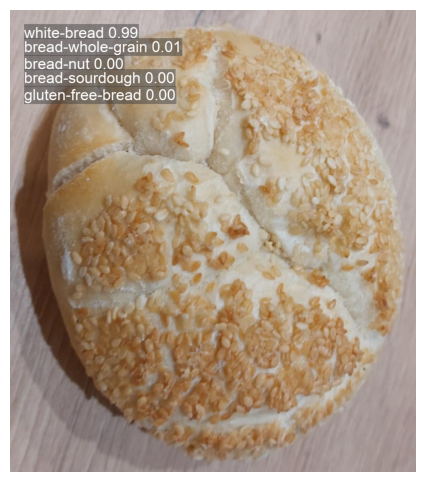

Processing image: data/test_pics/dom\bread4.jpg


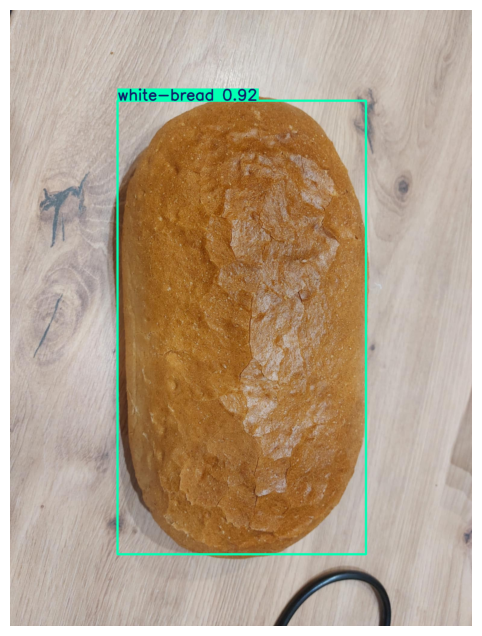

Detection 'white-bread' mapped to classification group 'bread-pasta-grains'


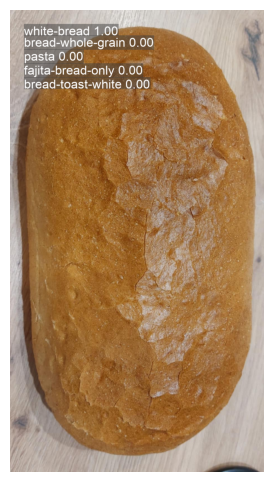

Processing image: data/test_pics/dom\bread5.jpg


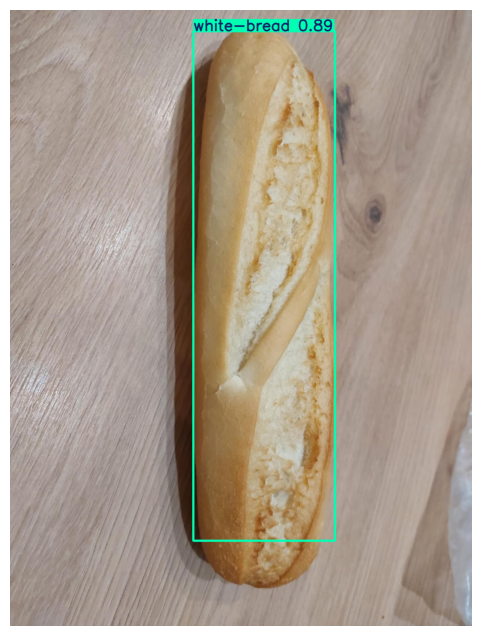

Detection 'white-bread' mapped to classification group 'bread-pasta-grains'


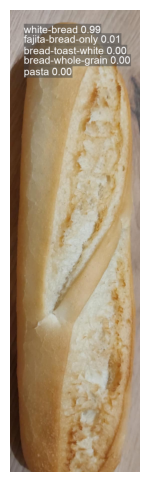

Processing image: data/test_pics/dom\broccoli.jpg


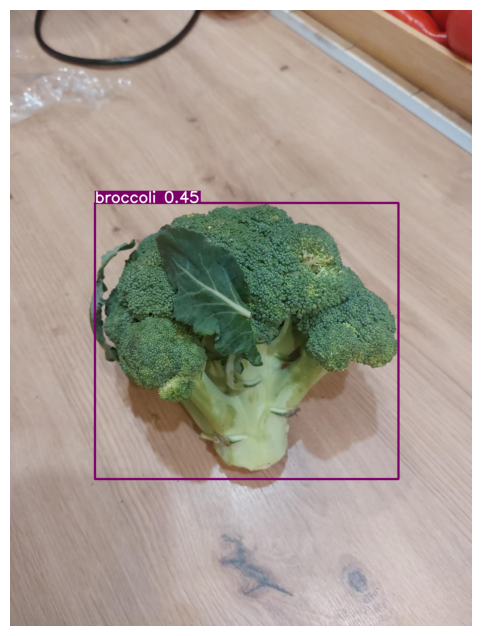

Detection 'broccoli' mapped to classification group 'vegetable'


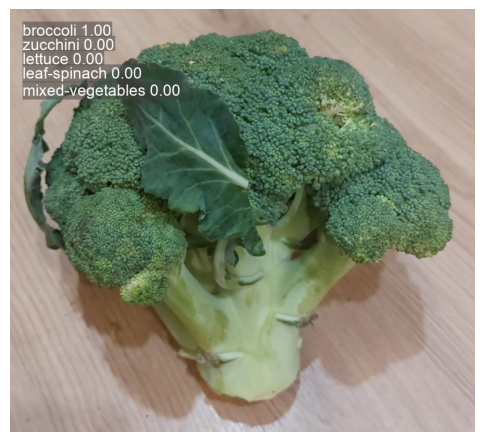

Processing image: data/test_pics/dom\croissant.jpg


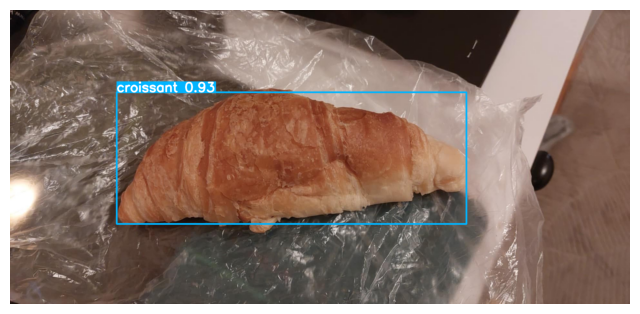

Detection 'croissant' mapped to classification group 'bread-pasta-grains'


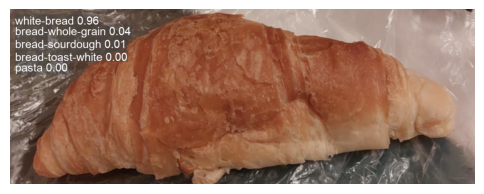

Processing image: data/test_pics/dom\cucumber1.jpg


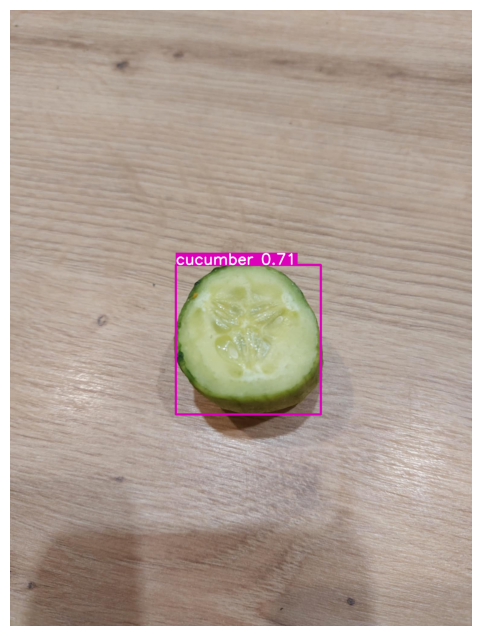

Detection 'cucumber' mapped to classification group 'vegetable'


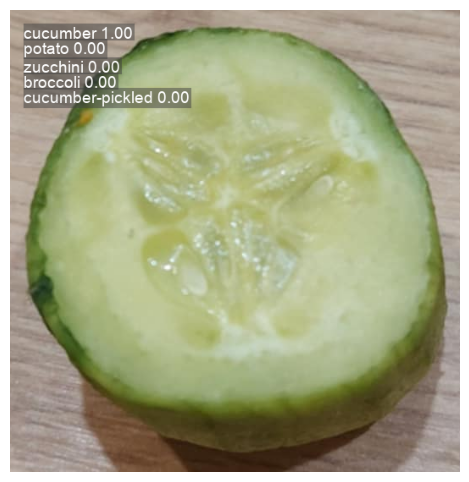

Processing image: data/test_pics/dom\cucumber2.jpg


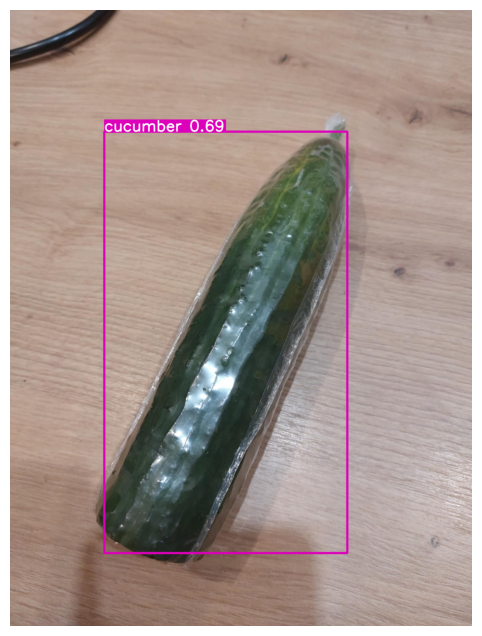

Detection 'cucumber' mapped to classification group 'vegetable'


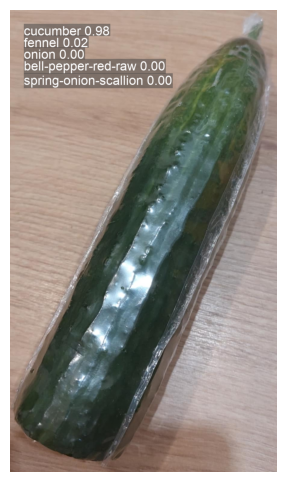

Processing image: data/test_pics/dom\dom1.jpg


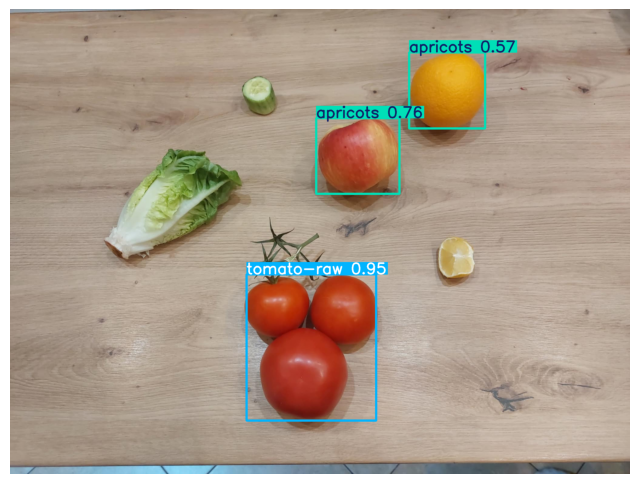

Detection 'tomato-raw' mapped to classification group 'vegetable'


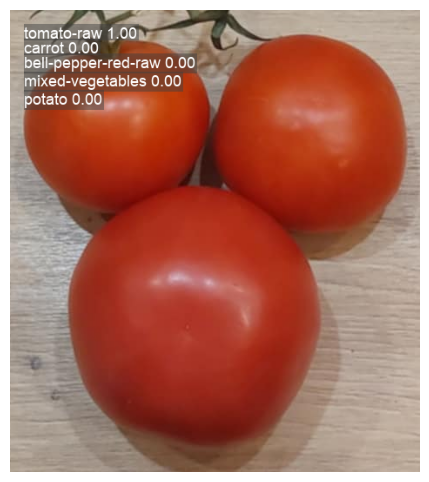

Detection 'apricots' mapped to classification group 'fruit'


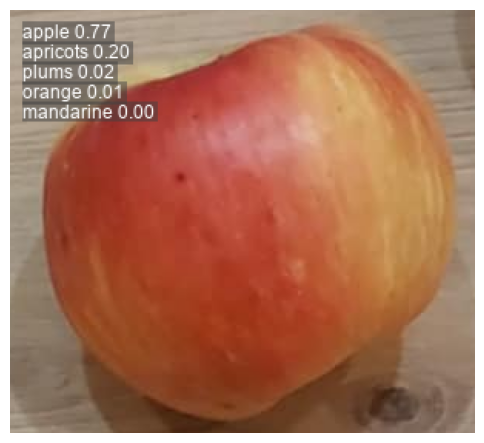

Detection 'apricots' mapped to classification group 'fruit'


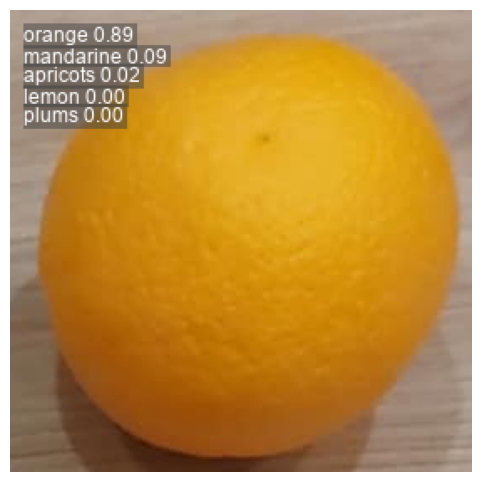

Processing image: data/test_pics/dom\dom2.jpg


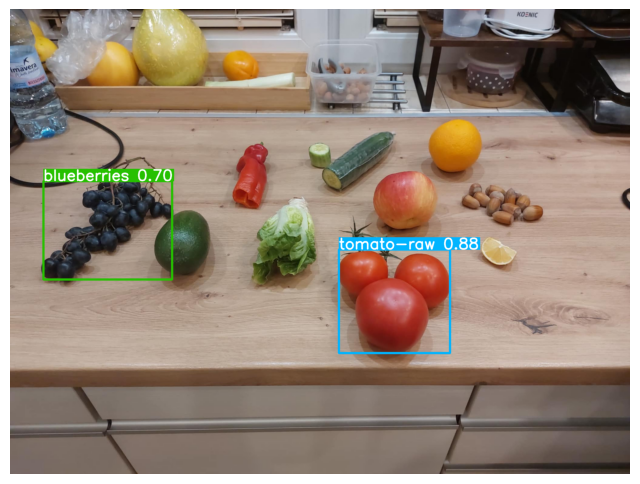

Detection 'tomato-raw' mapped to classification group 'vegetable'


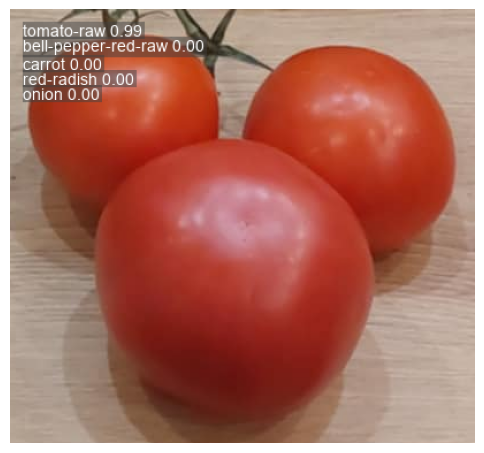

Detection 'blueberries' mapped to classification group 'fruit'


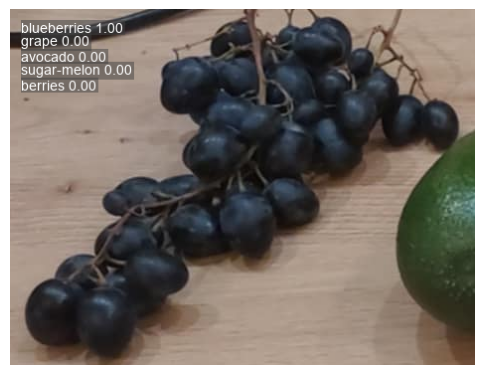

Processing image: data/test_pics/dom\dom3.jpg


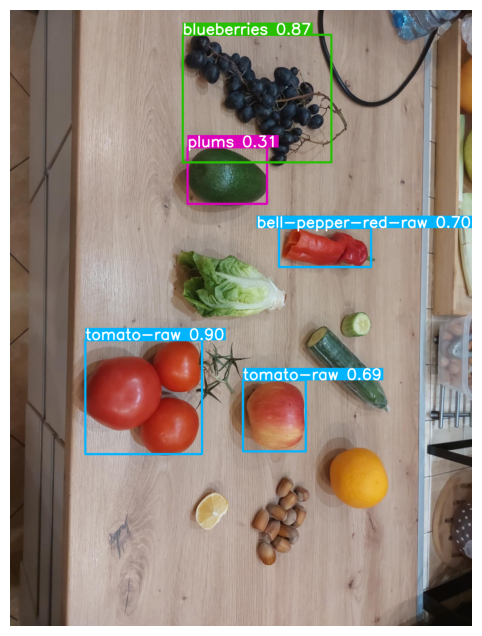

Detection 'tomato-raw' mapped to classification group 'vegetable'


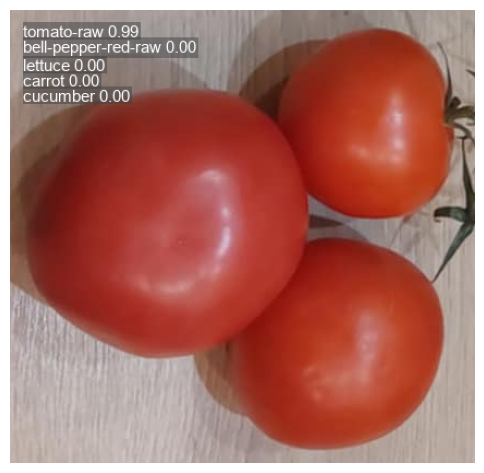

Detection 'blueberries' mapped to classification group 'fruit'


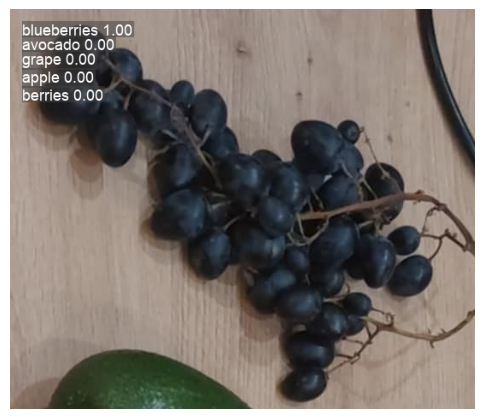

Detection 'bell-pepper-red-raw' mapped to classification group 'vegetable'


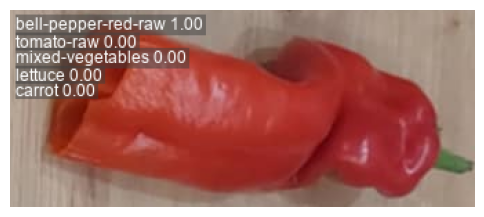

Detection 'tomato-raw' mapped to classification group 'vegetable'


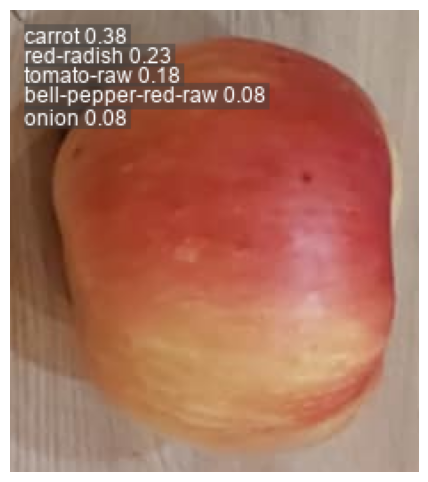

Detection 'plums' mapped to classification group 'fruit'


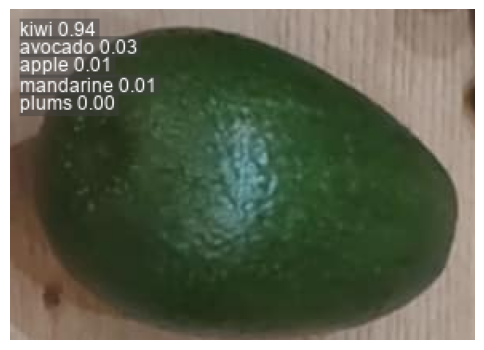

Processing image: data/test_pics/dom\grapes.jpg


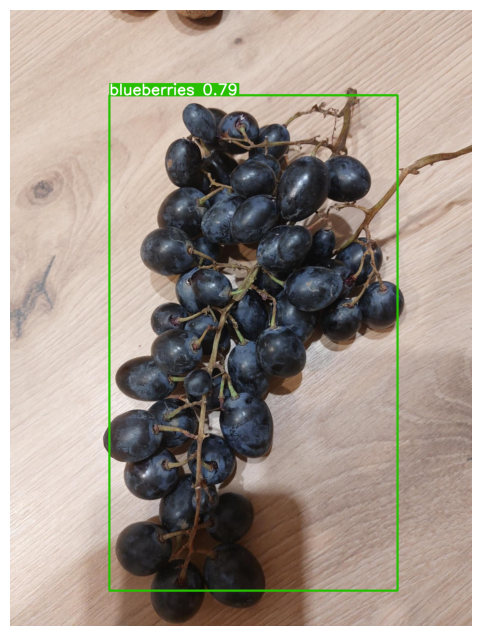

Detection 'blueberries' mapped to classification group 'fruit'


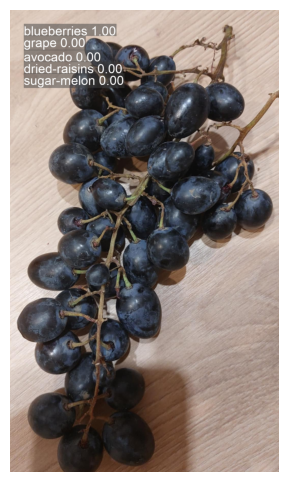

Processing image: data/test_pics/dom\images.jpg


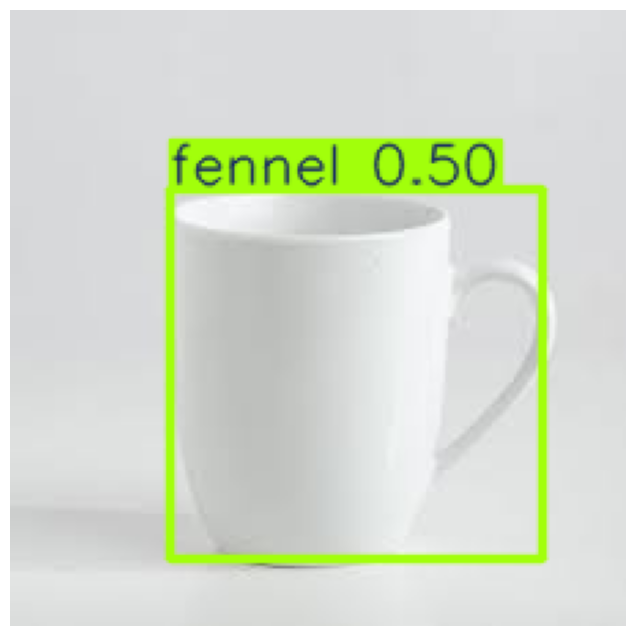

Detection 'fennel' mapped to classification group 'vegetable'


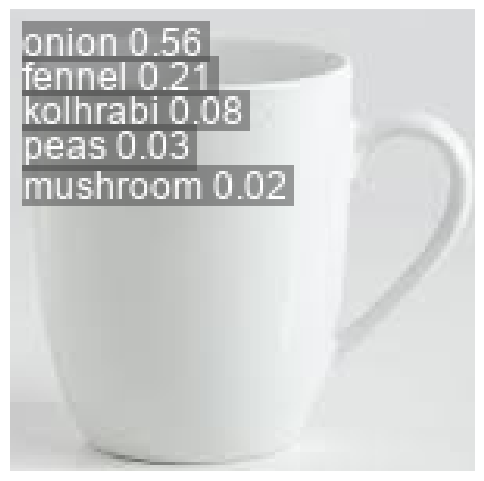

Processing image: data/test_pics/dom\istockphoto-530813862-170667a.jpg


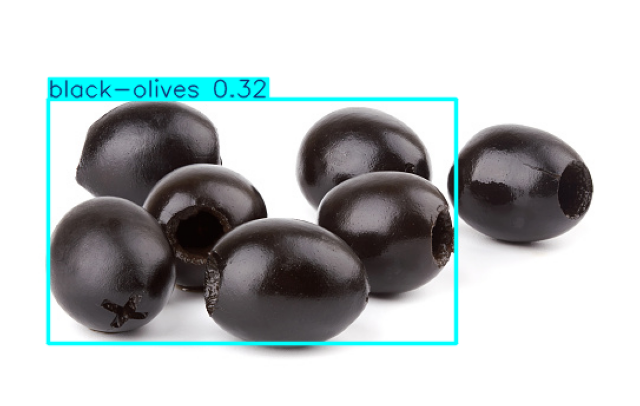

Detection 'black-olives' mapped to classification group 'vegetable'


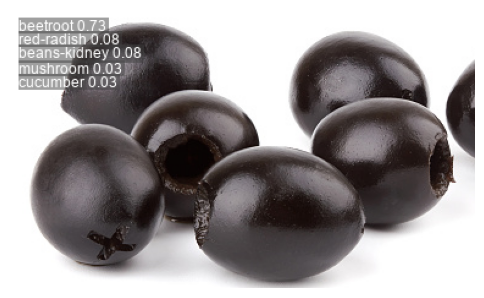

Processing image: data/test_pics/dom\jaja.jpg


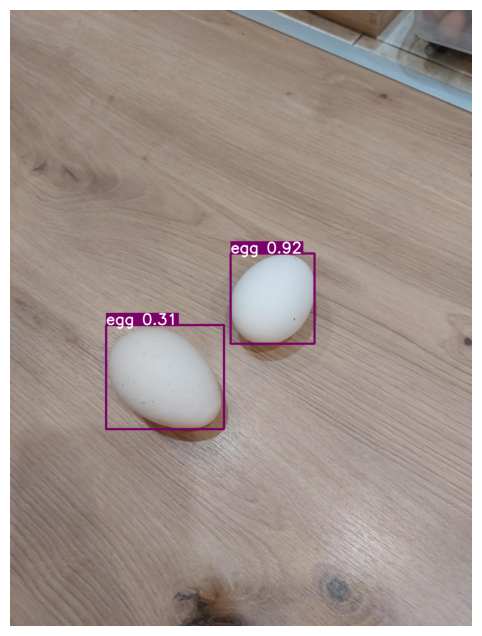

Detection 'egg' mapped to classification group 'cheese-dairy'


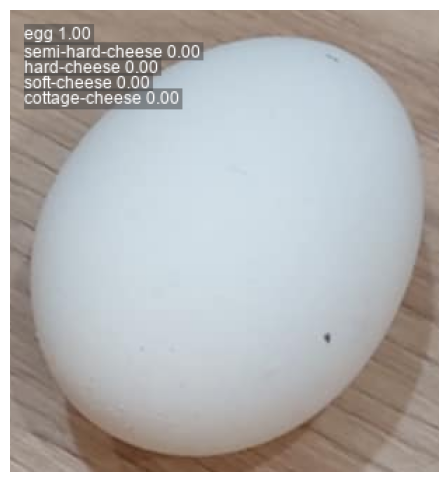

Detection 'egg' mapped to classification group 'cheese-dairy'


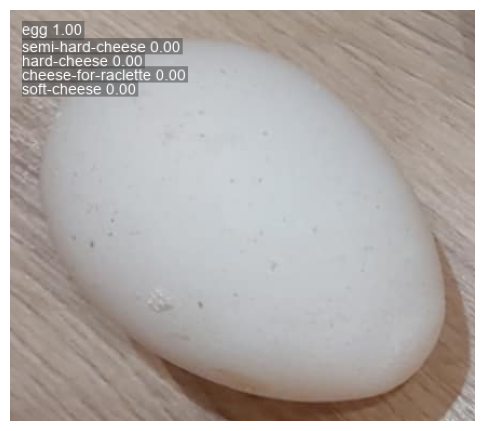

Processing image: data/test_pics/dom\jajaduzo.jpg


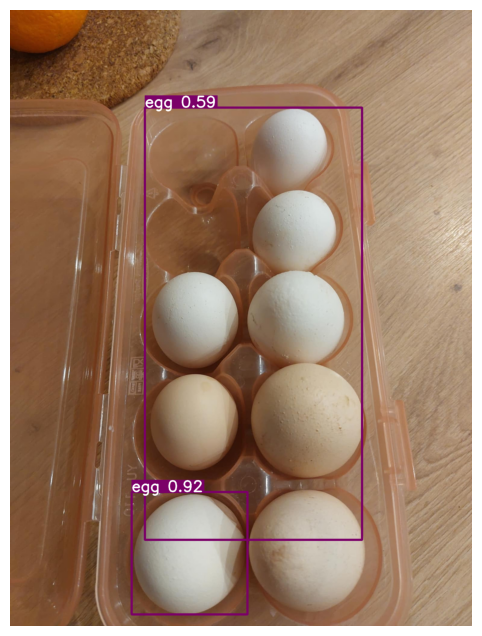

Detection 'egg' mapped to classification group 'cheese-dairy'


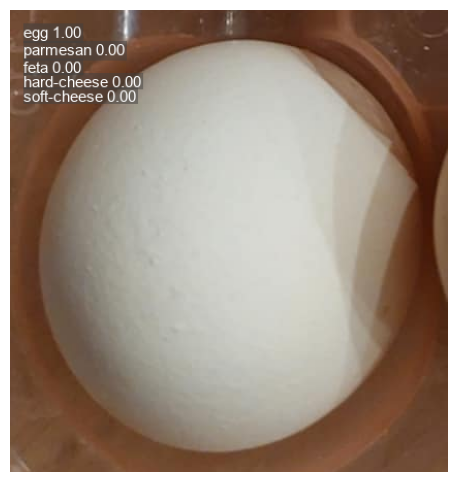

Detection 'egg' mapped to classification group 'cheese-dairy'


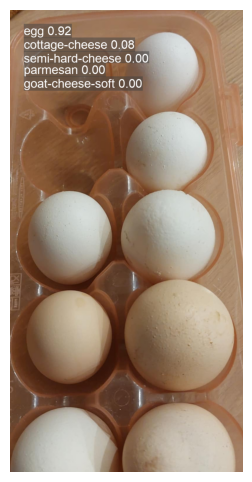

Processing image: data/test_pics/dom\jajo.jpg


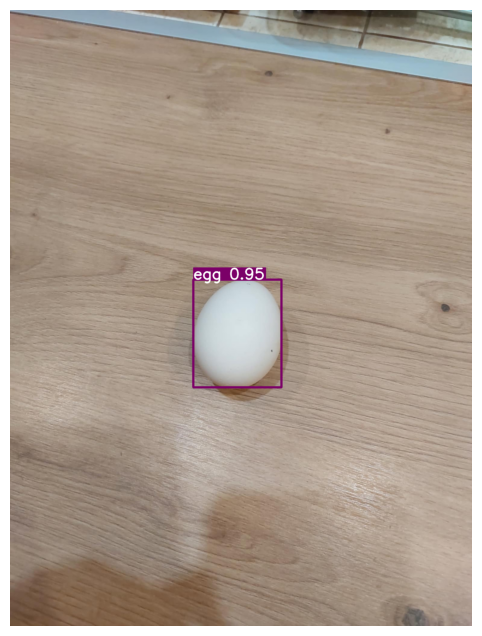

Detection 'egg' mapped to classification group 'cheese-dairy'


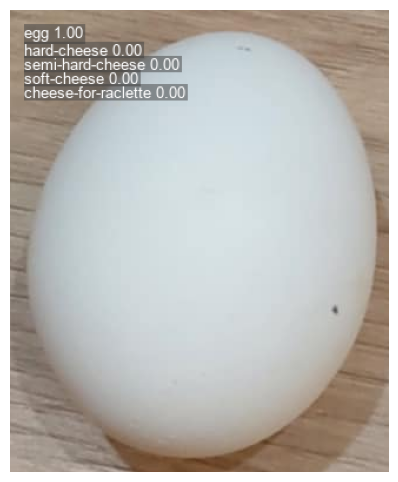

Processing image: data/test_pics/dom\kiszone.jpg


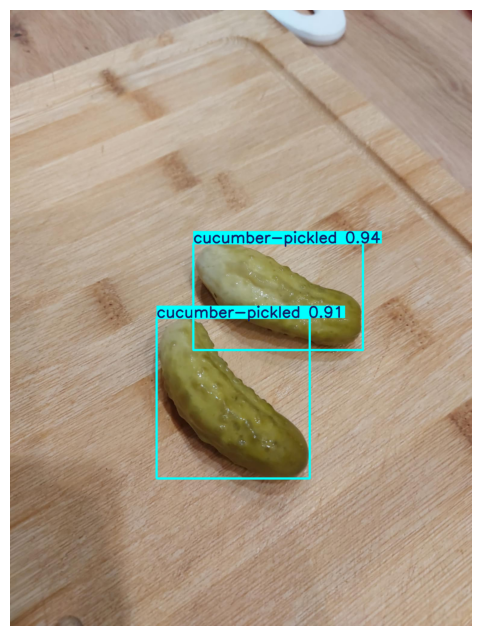

Detection 'cucumber-pickled' mapped to classification group 'vegetable'


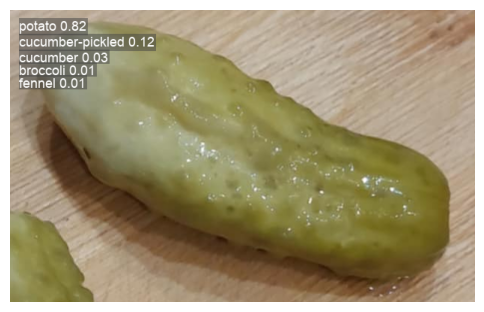

Detection 'cucumber-pickled' mapped to classification group 'vegetable'


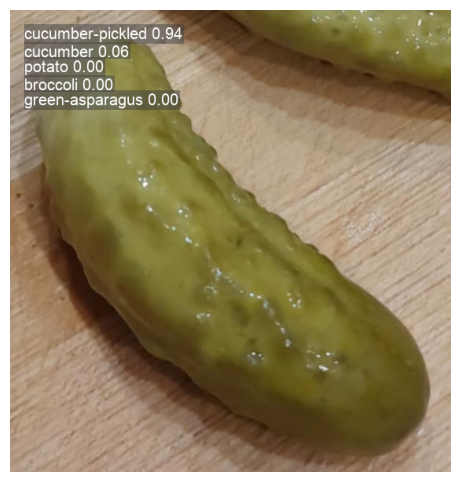

Processing image: data/test_pics/dom\kotlety.jpg


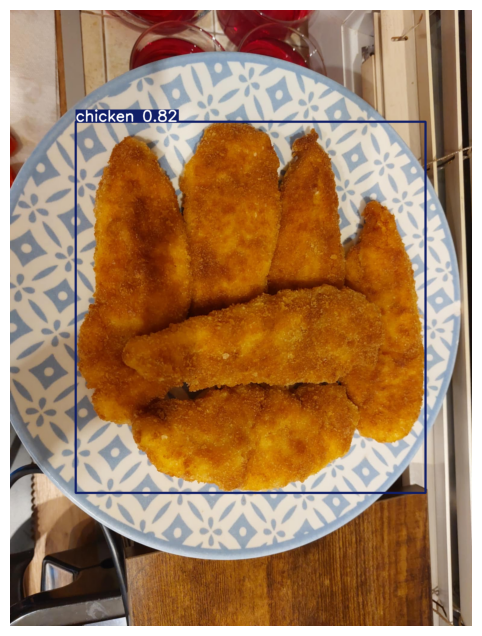

Detection 'chicken' mapped to classification group 'meat'


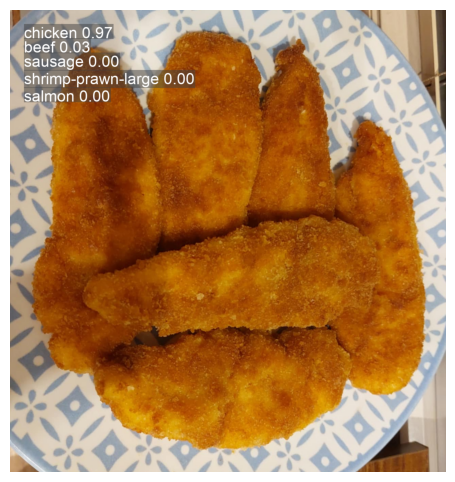

Processing image: data/test_pics/dom\lettuce.jpg


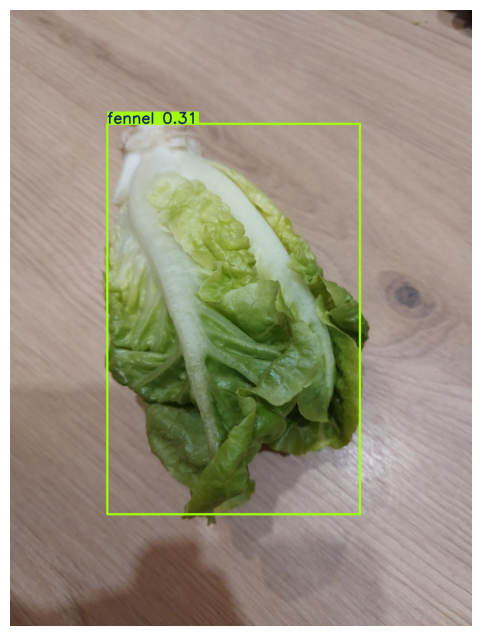

Detection 'fennel' mapped to classification group 'vegetable'


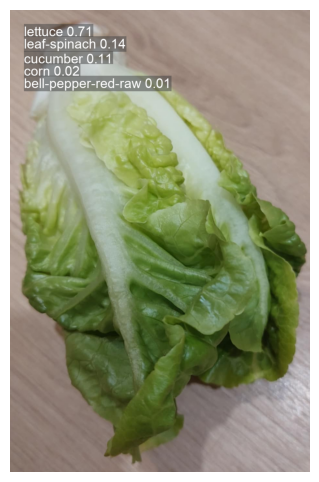

Processing image: data/test_pics/dom\nut.jpg


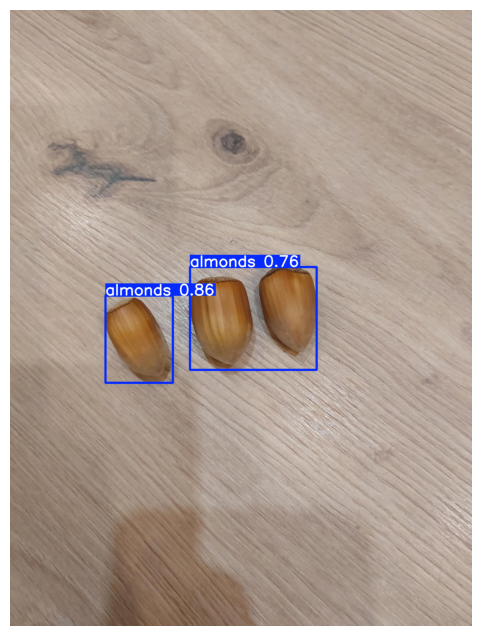

Detection 'almonds' mapped to classification group 'nuts-seeds'


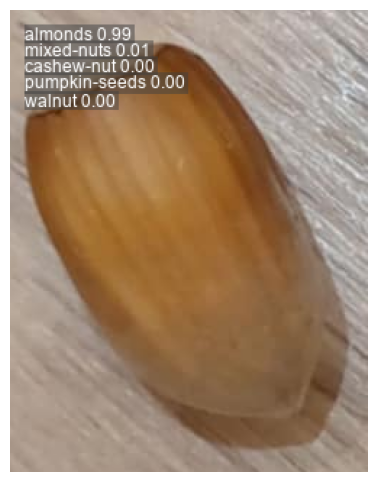

Detection 'almonds' mapped to classification group 'nuts-seeds'


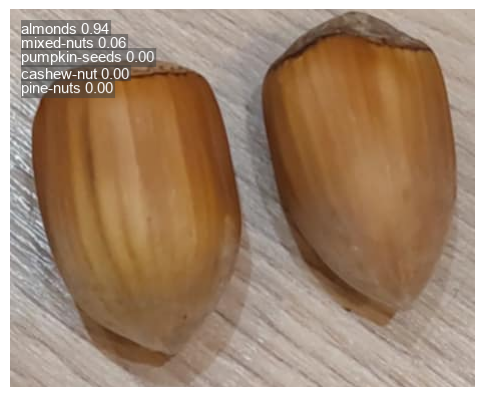

Processing image: data/test_pics/dom\nut2.jpg


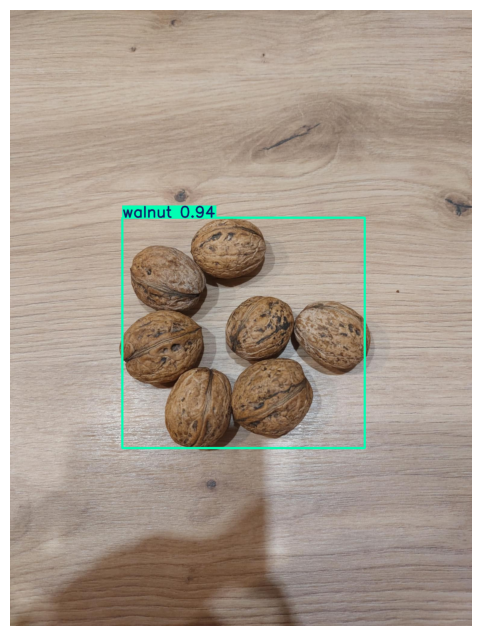

Detection 'walnut' mapped to classification group 'nuts-seeds'


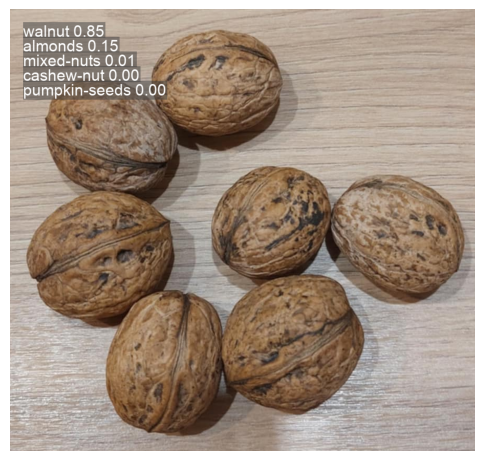

Processing image: data/test_pics/dom\obiad1.jpg


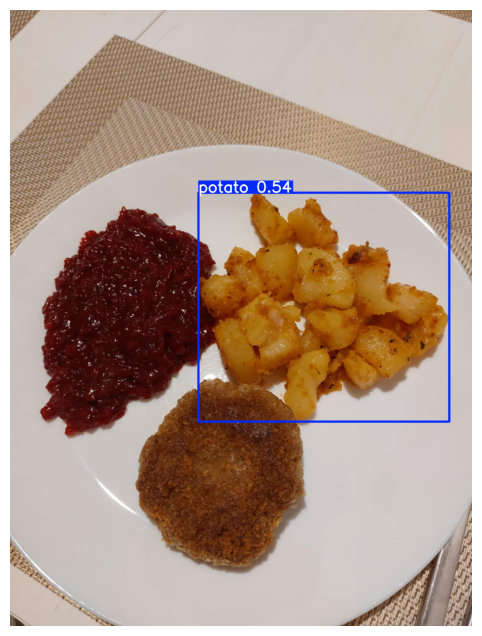

Detection 'potato' mapped to classification group 'vegetable'


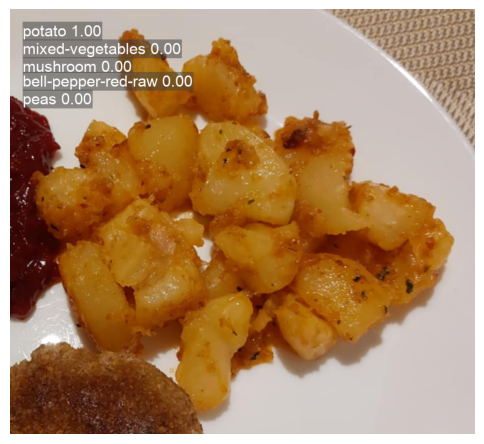

Processing image: data/test_pics/dom\olives.jpg


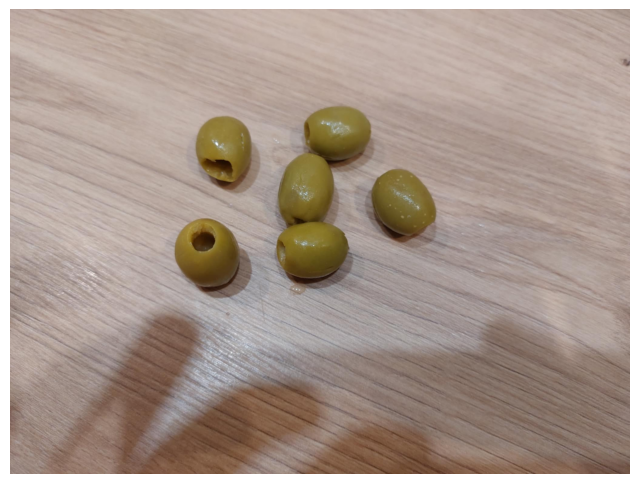

Processing image: data/test_pics/dom\onion.jpg


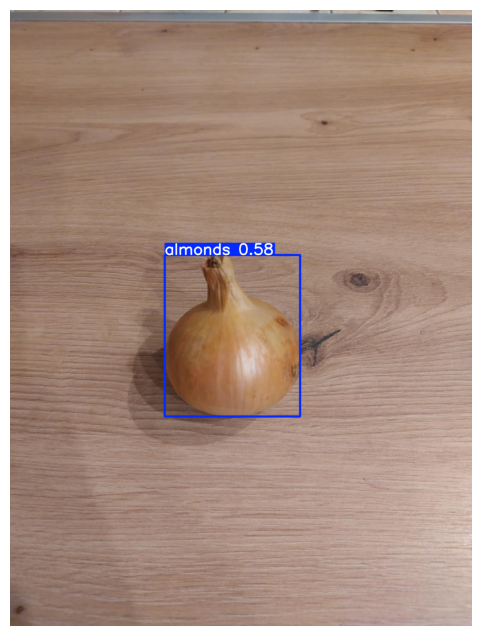

Detection 'almonds' mapped to classification group 'nuts-seeds'


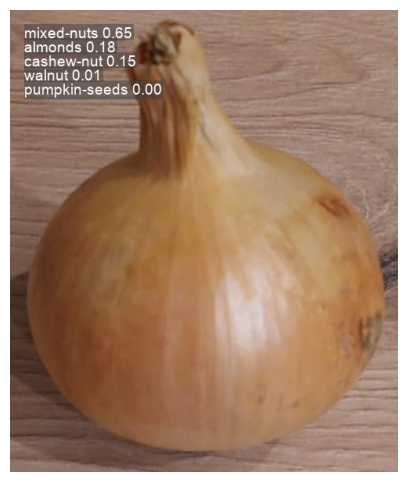

Processing image: data/test_pics/dom\onion2.jpg


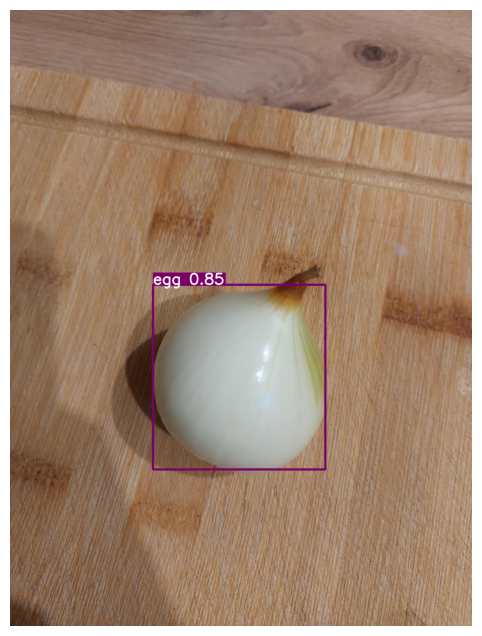

Detection 'egg' mapped to classification group 'cheese-dairy'


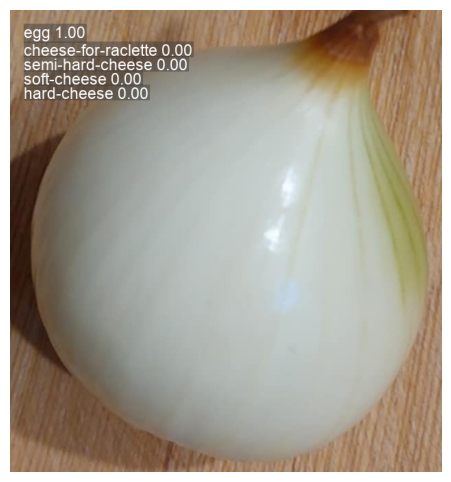

Processing image: data/test_pics/dom\orange.jpg


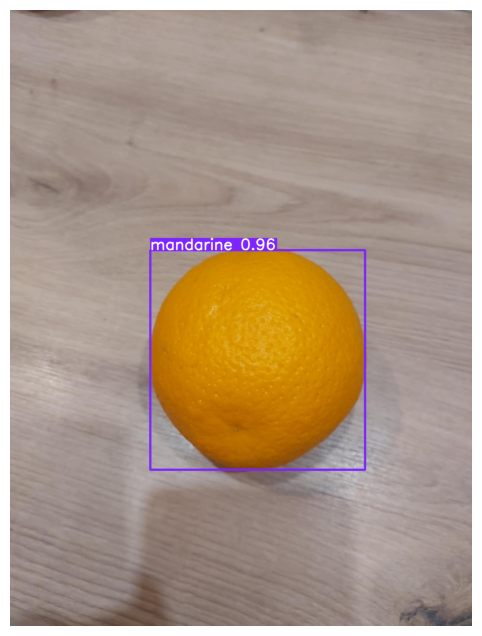

Detection 'mandarine' mapped to classification group 'fruit'


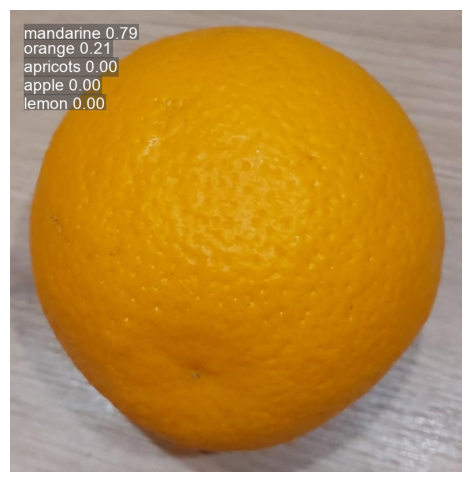

Processing image: data/test_pics/dom\pepper.jpg


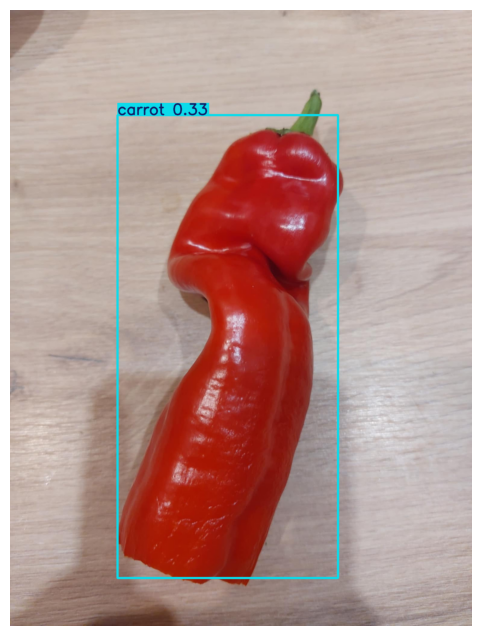

Detection 'carrot' mapped to classification group 'vegetable'


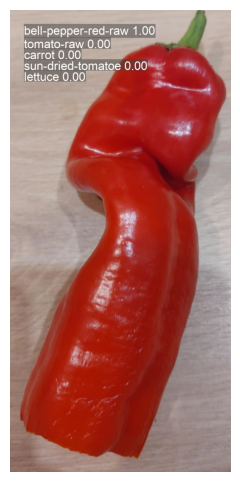

Processing image: data/test_pics/dom\pizza_ham.jpg


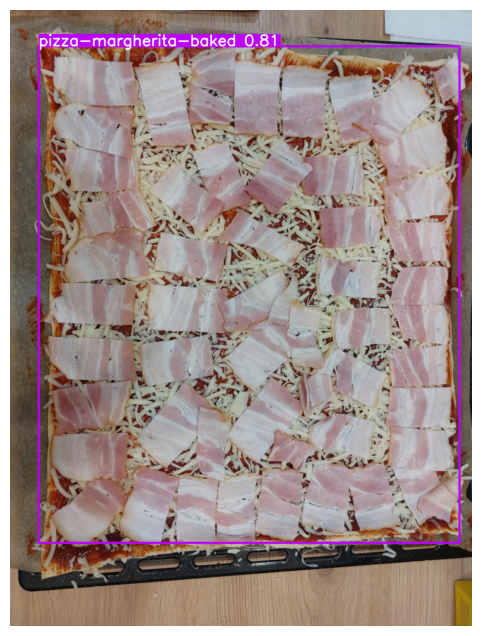

Detection 'pizza-margherita-baked' mapped to classification group 'misc'


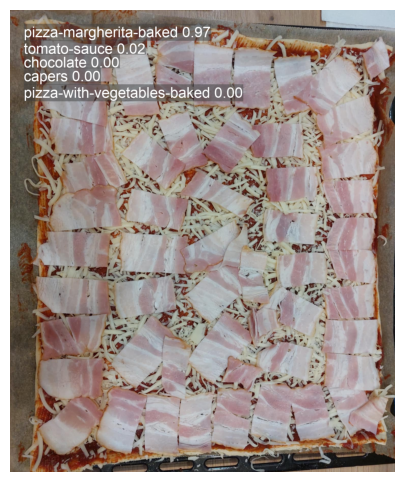

Processing image: data/test_pics/dom\pizza_ingr.jpg


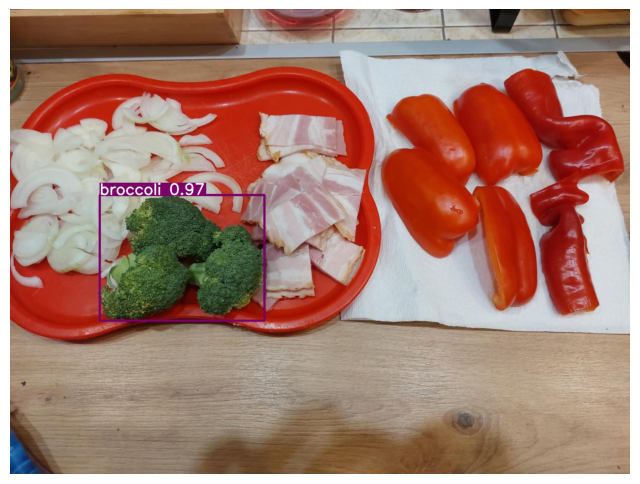

Detection 'broccoli' mapped to classification group 'vegetable'


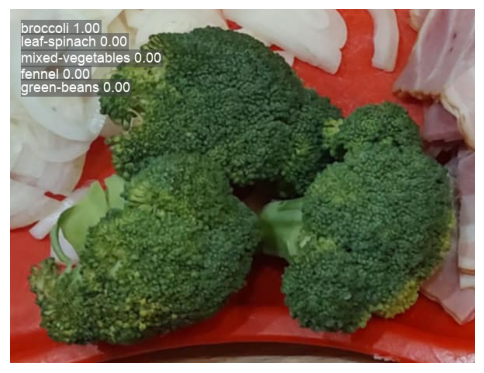

Processing image: data/test_pics/dom\pizza_post.jpg


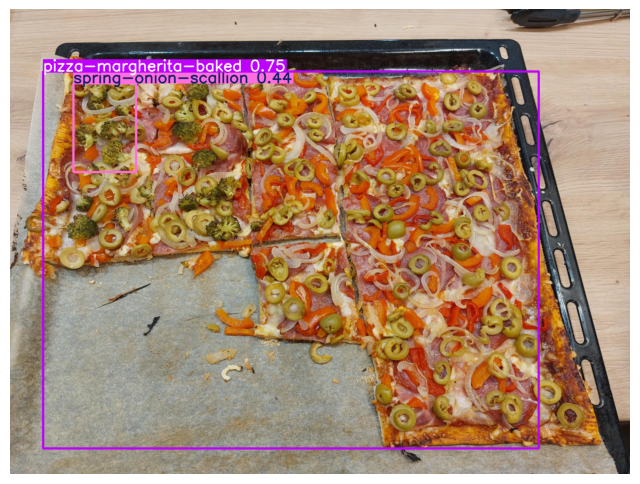

Detection 'pizza-margherita-baked' mapped to classification group 'misc'


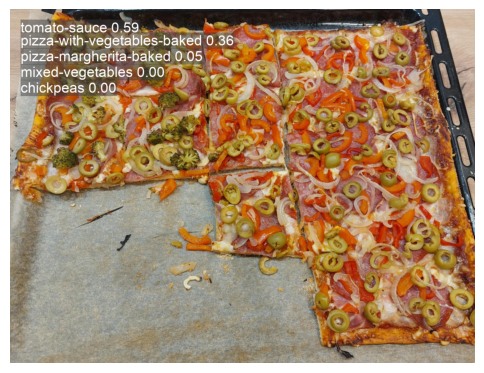

Detection 'spring-onion-scallion' mapped to classification group 'vegetable'


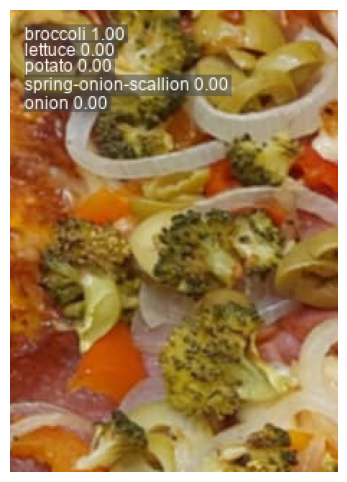

Processing image: data/test_pics/dom\pizza_pre.jpg


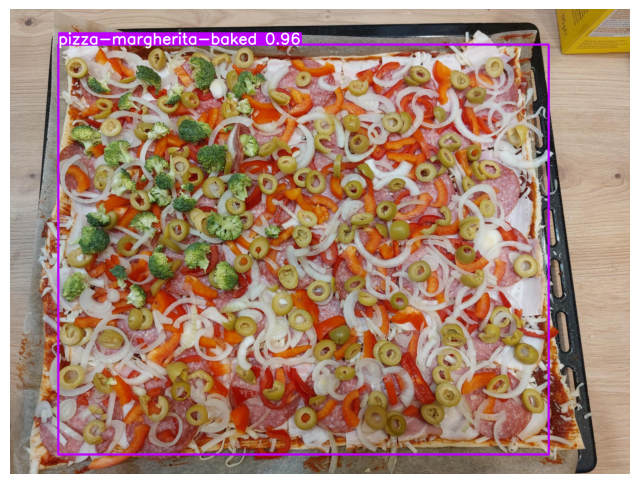

Detection 'pizza-margherita-baked' mapped to classification group 'misc'


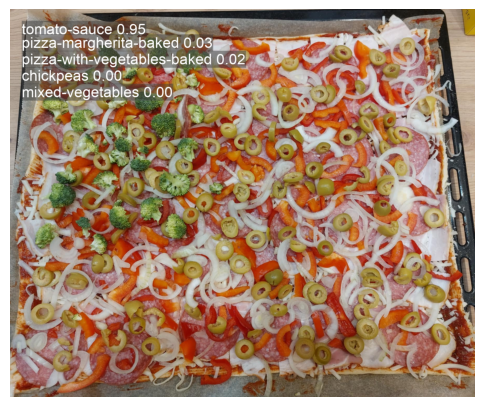

Processing image: data/test_pics/dom\pizza_slices.jpg


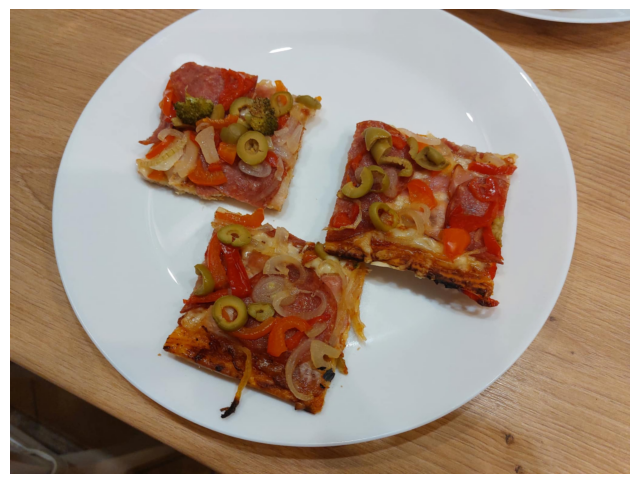

Processing image: data/test_pics/dom\sandwich.jpg


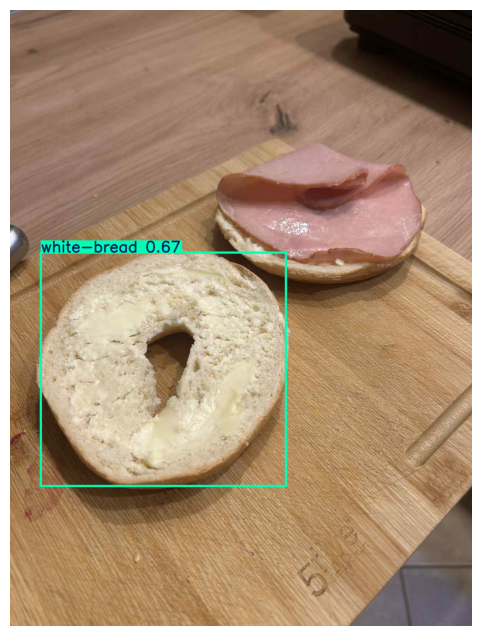

Detection 'white-bread' mapped to classification group 'bread-pasta-grains'


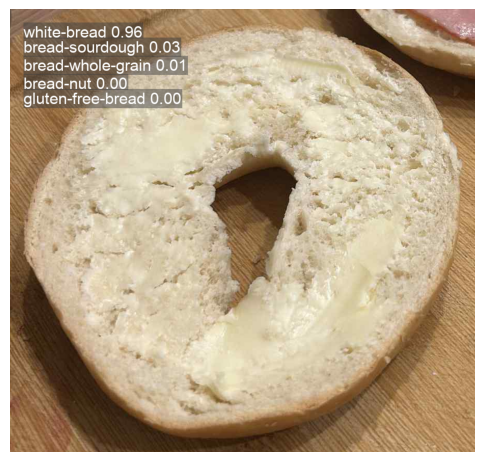

Processing image: data/test_pics/dom\winogrona.jpg


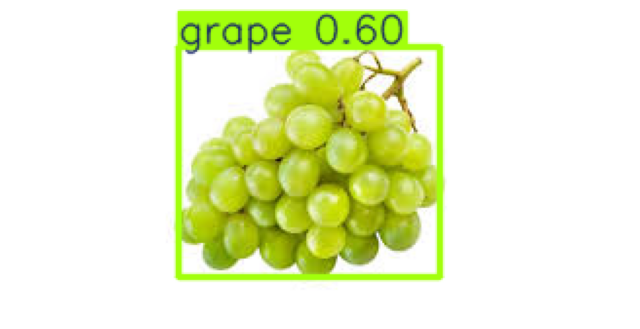

Detection 'grape' mapped to classification group 'fruit'


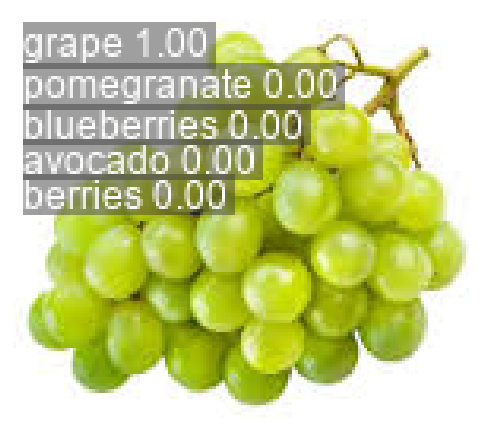

In [40]:
import os
img_dir = "data/test_pics/dom"

for img_file in os.listdir(img_dir):
    if img_file.lower().endswith(('.png', '.jpg', '.jpeg')):
        img_path = os.path.join(img_dir, img_file)
        print(f"Processing image: {img_path}")
        model.run(image_path=img_path, conf_threshold=0.3, det_imgsz=800,
                  vis=True, vis_crops=True, verbose=True)